# CLINT WP5: MultiMaps of anomaly of drivers (w/r to 1981-2010) in detected areas and periods. 
## Upgrade to the use of historical CMCC-CM2-SR5
### 2023/10/12 - ongoing


In [1]:
import numpy as np
import pandas as pd
import xarray as xr
import netCDF4 as nc
from datetime import datetime as dt
import matplotlib.pyplot as plt
import matplotlib as mpl
import cartopy.crs as ccrs
import cartopy
import importlib
import seaborn as sns
#from mpl_toolkits import Basemap
import CLINT001_functions as clint
importlib.reload(clint)

<module 'CLINT001_functions' from '/users_home/csp/as18623/CLINT001_functions.py'>

In [2]:
## DIRECTORIES
machine = 'juno'
kind = 'hist' #ERA5 or hist


if machine == 'laptop':
    modeldir = '~/Documents/CMCC-GoogleDrive/ERA5/'
    metadatadir = '~/Library/Mobile\ Documents/com~apple~CloudDocs/CLINT/metadata/'
    maskdir = '~/Documents/CMCC-GoogleDrive/Mask_Clusters/Test3_Clusters/'
    plotdir = '/Users/squintu/Documents/CMCC-GoogleDrive/plots_for_reports/'
    
if machine == 'workstation':
    modeldir = '~/Documents/CMCC-GoogleDrive/ERA5/'
    metadatadir = '~/Library/Mobile\ Documents/com~apple~CloudDocs/CLINT/metadata/'
    maskdir = '~/Documents/CMCC-GoogleDrive/Mask_Clusters/Test3_Clusters/'
    plotdir = '/Users/antonellosquintu/Documents/CMCC-GoogleDrive/plots_for_reports/'

if machine == 'juno':
    modeldir = f'/work/csp/as18623/CLINT_{kind}/'
    obsdir = '/data/csp/as18623/CLINT_obs/'
    workmetadir = '/work/csp/as18623/CLINT_metadata/'
    metadatadir = '/data/csp/as18623/CLINT_metadata/'
    maskdir = '/data/csp/as18623/CLINT_metadata/Masks/Test3_Clusters/'
    plotdir = '/work/csp/as18623/CLINT_WP5/maps_and_plots/'

In [3]:
modelspecs = pd.DataFrame({'kind':['ERA5','hist'],
                           'modelnames':['era5','CMCC-CM2-SR5'],#name of models
                           'members_list':[np.nan,np.array(range(3,12))]})#list of member numbers)

modelspecs = pd.DataFrame({'kind':['ERA5','hist'],
                           'modelnames':['era5','CMCC-CM2-SR5'],#name of models
                           'members_list':[np.nan,[3]]})#list of member numbers)


In [4]:
modelspecs

,kind,modelnames,members_list
0,ERA5,era5,NaN
1,hist,CMCC-CM2-SR5,[3]


In [5]:
## Open land-sea mask and round to integer
## The mask has values between 0 and 1 according to the proportion of the grid-point
##  which is covered by land
## Any gridpoint with more than 0.5 is rounded to 1 and considered land

lsm = xr.open_dataset(f'{obsdir}/era5_lsm.nc').round()

In [6]:
### Read series of tmax and HWMI related to Lake Como
lchw = pd.read_csv('LakeComo_tmax_HW.csv',index_col='date')

In [7]:
### Identify 2019 heat wave

row_maxHWMI = lchw.loc[lchw['Valle_HWintensity'].idxmax()]
date2019_dt = dt.strptime(row_maxHWMI.name,"%Y-%m-%d")
date2019_ts = pd.to_datetime(date2019_dt)

In [8]:
### Identify dates
date_aux_dt = dt.strptime(lchw.loc[lchw.year==1983]['Valle_HWintensity'].idxmax(),"%Y-%m-%d")
date_aux_ts = pd.to_datetime(date_aux_dt)

In [9]:
variables = ['tmax']

In [29]:
## indicate the date of the events and the variables to be included

dates_ts = (pd.to_datetime("2022-07-22"), 
            pd.to_datetime("2019-06-27"), 
            pd.to_datetime("2003-08-11"), 
            pd.to_datetime("1983-07-21"))

## don't run too many dates at once otherwise the notebook won't open next time

dates_ts =[pd.to_datetime("2019-06-27")]
if kind == 'ERA5':
    houroffset = 0 #daily files of era5 are labeled with 00 UTC
else:
    houroffset = 12 #daily files of CMIP6 are labeled with 12 UTC

dates_ts1 = dates_ts
dates_ts = [d + pd.DateOffset(hours = houroffset) for d in dates_ts1]

variables = ['mslp']



In [30]:
dates_ts

[Timestamp('2019-06-27 12:00:00')]

2019-06-27 12:00:00
2019-06-26 12:00:00
2019-06-25 12:00:00
2019-06-24 12:00:00
2019-06-23 12:00:00
2019-06-22 12:00:00
2019-06-21 12:00:00
2019-06-20 12:00:00
2019-06-19 12:00:00


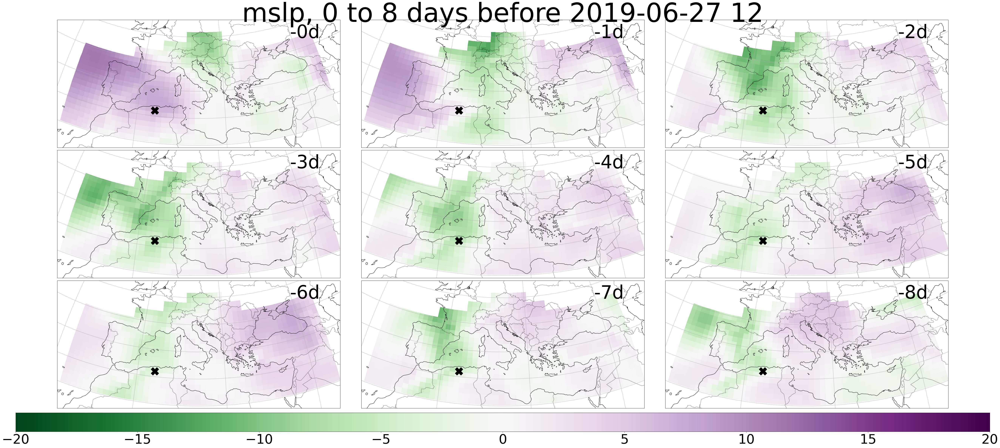

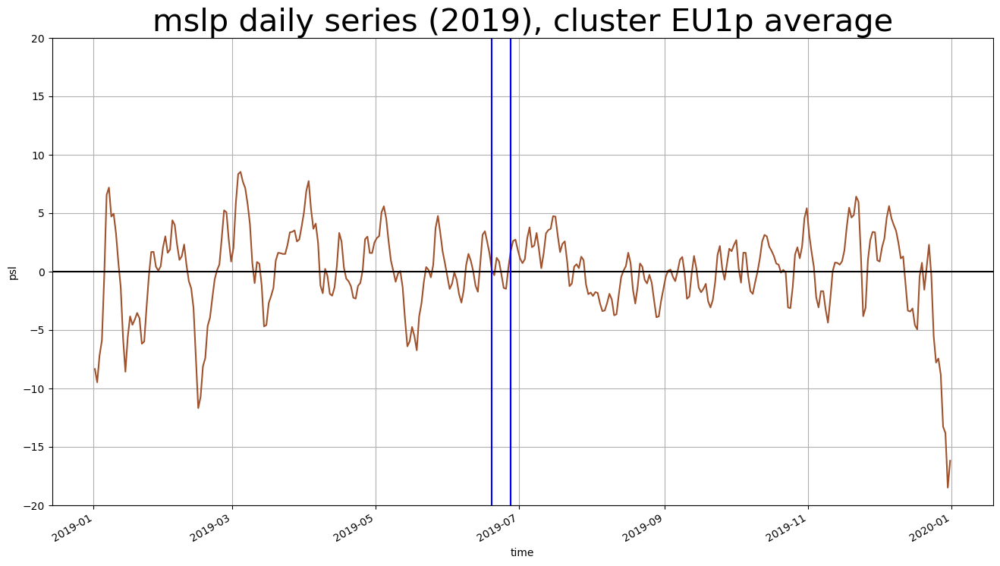

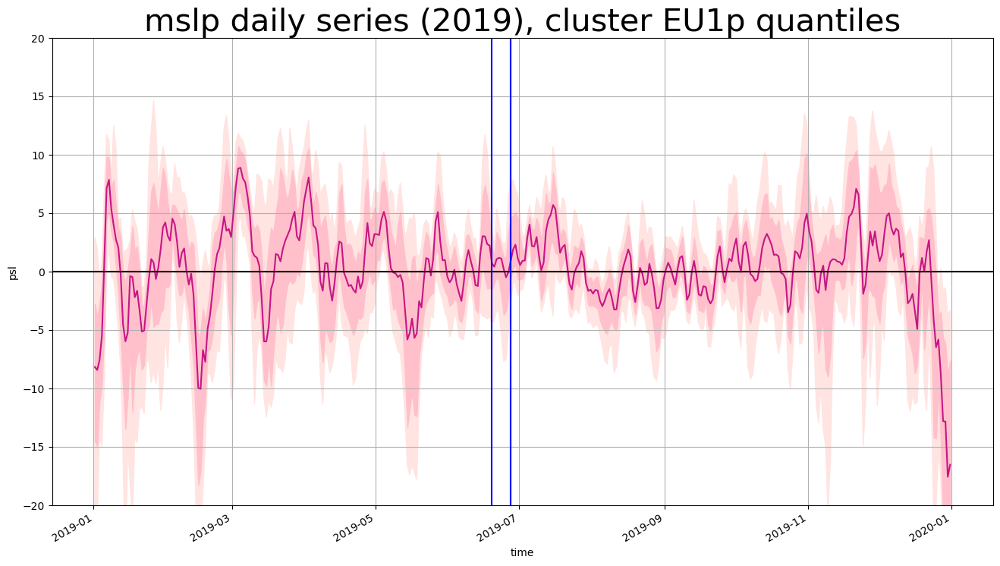

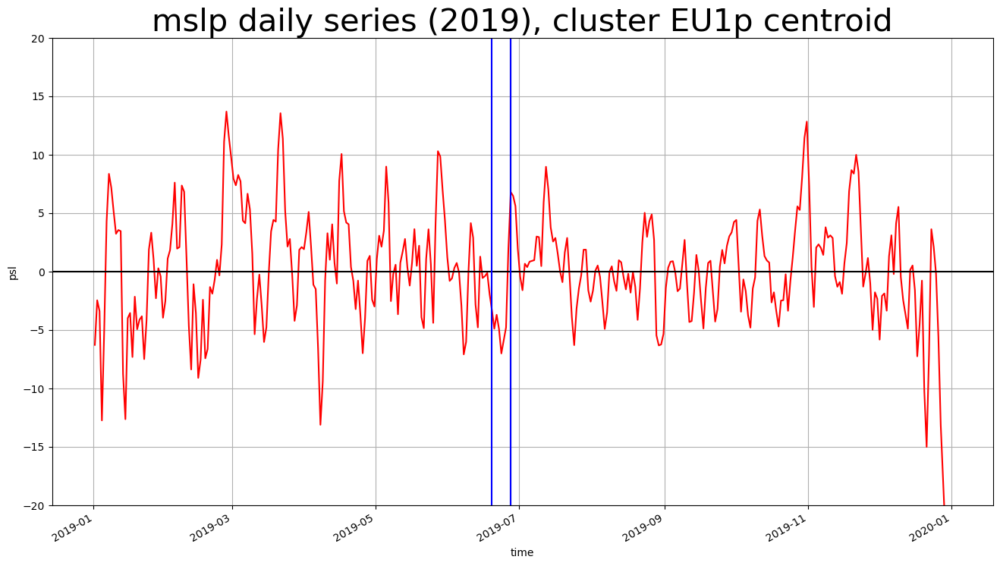

2019-04-18 12:00:00
2019-04-17 12:00:00
2019-04-16 12:00:00
2019-04-15 12:00:00
2019-04-14 12:00:00
2019-04-13 12:00:00
2019-04-12 12:00:00
2019-04-11 12:00:00
2019-04-10 12:00:00
2019-04-09 12:00:00
2019-04-08 12:00:00
2019-04-07 12:00:00
2019-04-06 12:00:00
2019-04-05 12:00:00
2019-04-04 12:00:00
2019-04-03 12:00:00
2019-04-02 12:00:00


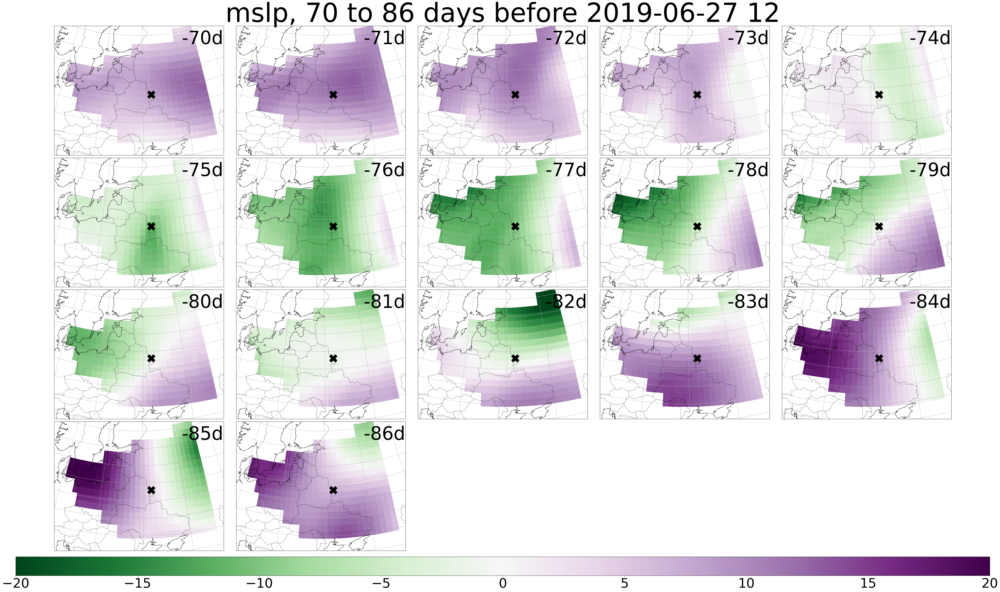

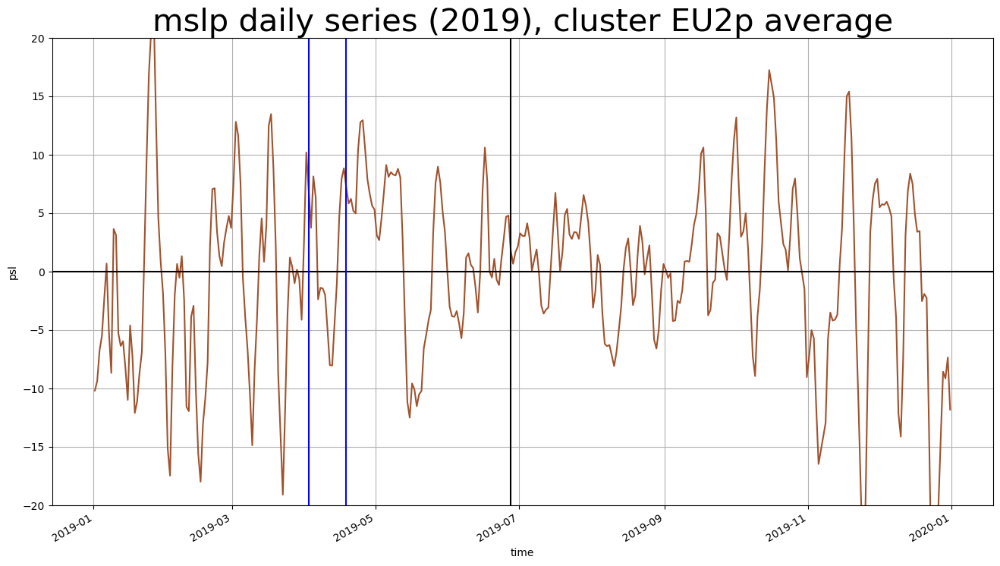

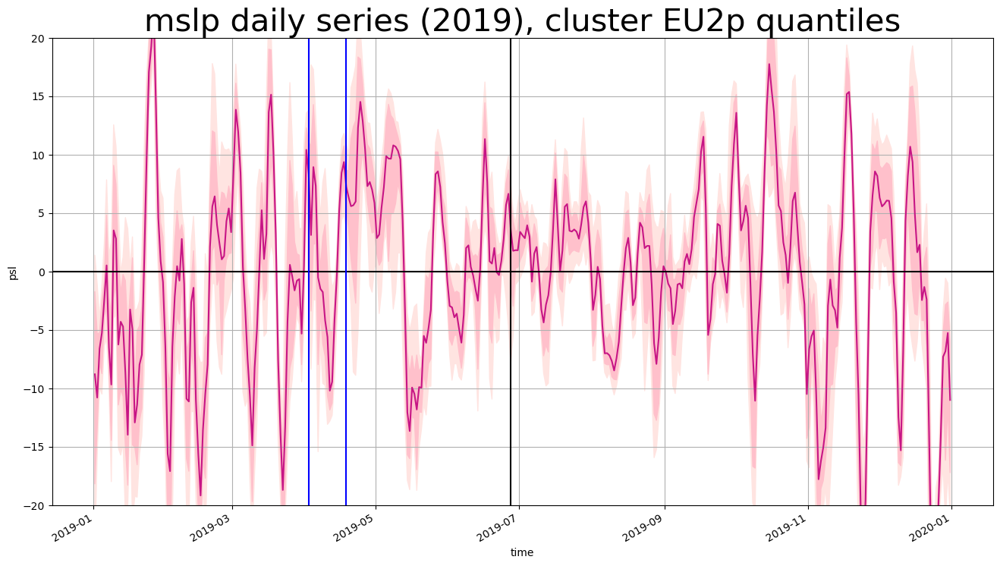

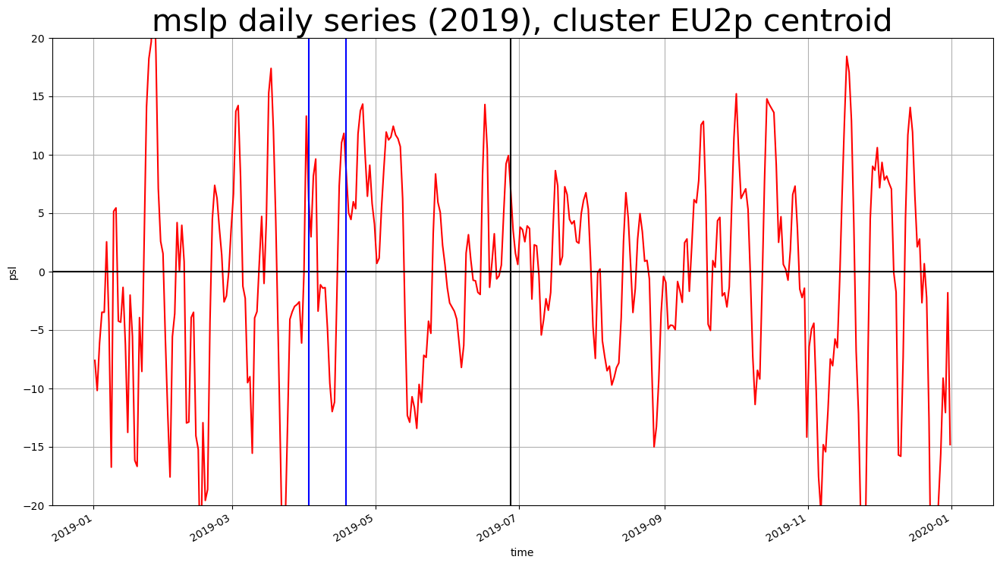

2019-05-18 12:00:00
2019-05-17 12:00:00
2019-05-16 12:00:00
2019-05-15 12:00:00
2019-05-14 12:00:00
2019-05-13 12:00:00
2019-05-12 12:00:00
2019-05-11 12:00:00
2019-05-10 12:00:00
2019-05-09 12:00:00
2019-05-08 12:00:00
2019-05-07 12:00:00
2019-05-06 12:00:00
2019-05-05 12:00:00
2019-05-04 12:00:00
2019-05-03 12:00:00
2019-05-02 12:00:00
2019-05-01 12:00:00
2019-04-30 12:00:00
2019-04-29 12:00:00
2019-04-28 12:00:00
2019-04-27 12:00:00


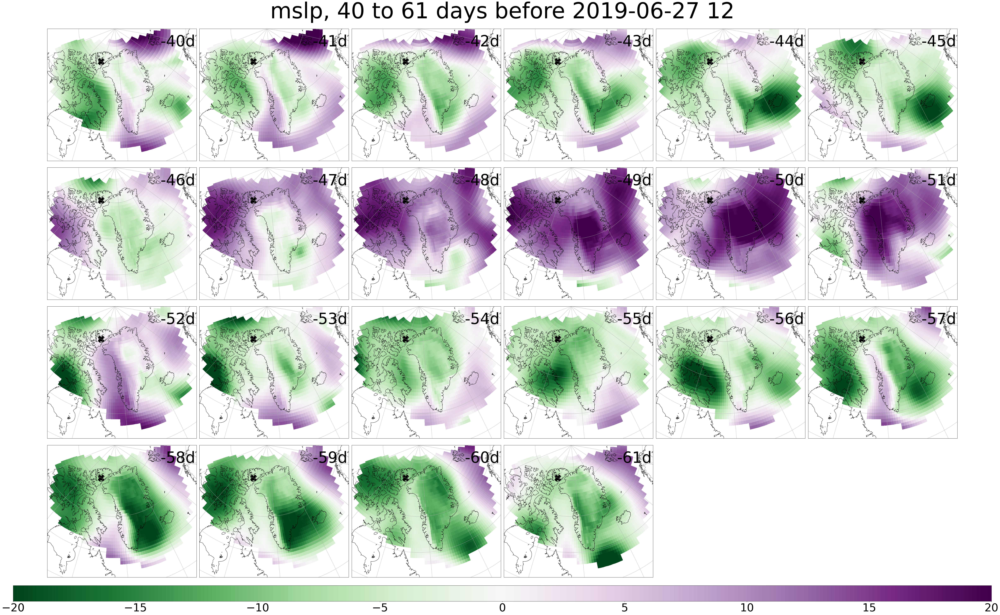

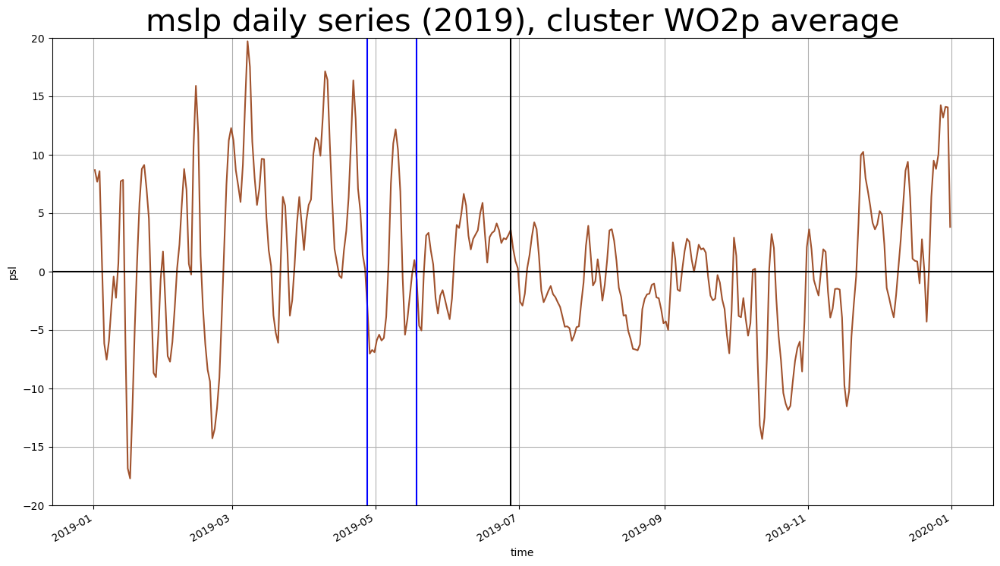

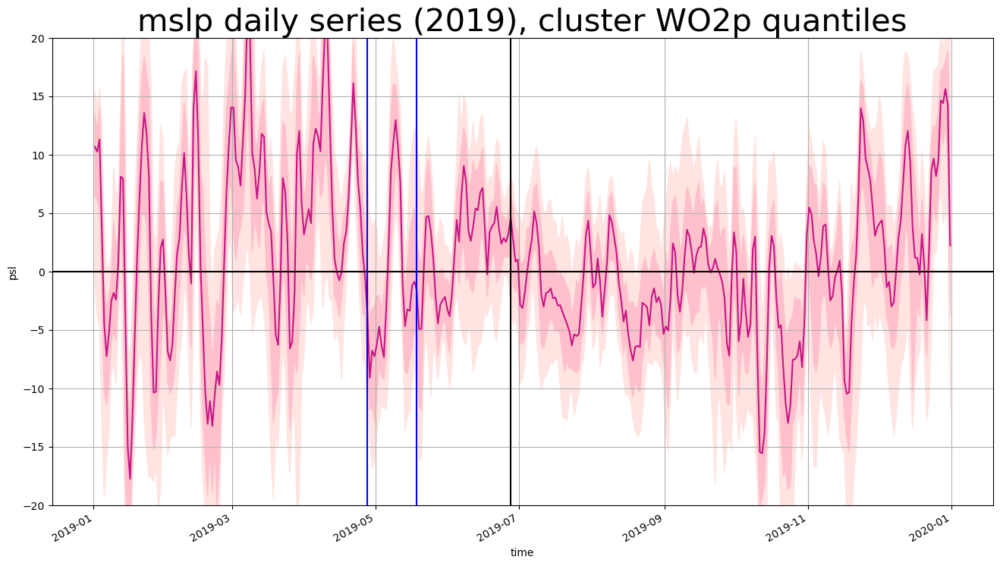

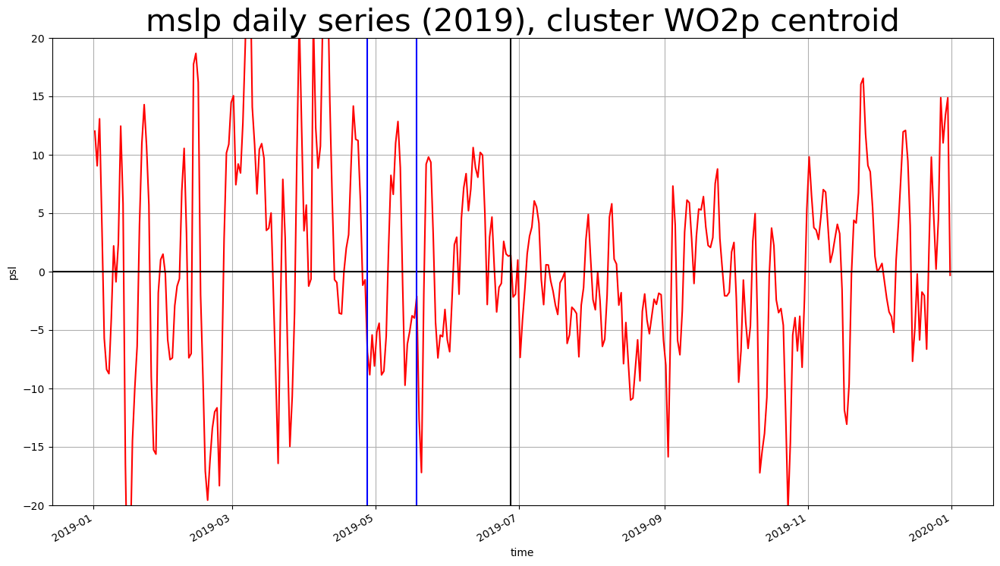

In [31]:
importlib.reload(clint)
drivers = pd.read_csv(f'{workmetadir}drivers.csv')
clint.loop_map_grids(drivers, dates_ts, variables, lsm, modelspecs[modelspecs.kind == kind],
                     modeldir, maskdir, plotdir)